<a href="https://colab.research.google.com/github/MushroomFleet/StableCascade-text2image/blob/main/240212_StableCascade_text2image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Check the GPU
!nvidia-smi

In [44]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
!git clone https://github.com/Stability-AI/StableCascade.git
%cd StableCascade
!pip install -r requirements.txt

Cloning into 'StableCascade'...
remote: Enumerating objects: 238, done.
remote: Counting objects: 100% (117/117), done.
remote: Compressing objects: 100% (85/85), done.
remote: Total 238 (delta 66), reused 49 (delta 32), pack-reused 121
Receiving objects: 100% (238/238), 118.71 MiB | 17.69 MiB/s, done.
Resolving deltas: 100% (86/86), done.
/content/StableCascade
Looking in links: https://download.pytorch.org/whl/torch_stable.html
  Cloning https://github.com/ildoonet/pytorch-gradual-warmup-lr.git to /tmp/pip-install-fxhu6fyw/warmup-scheduler_c5dd323a8dec4f67abd1d5301fc494cd
  Running command git clone --filter=blob:none --quiet https://github.com/ildoonet/pytorch-gradual-warmup-lr.git /tmp/pip-install-fxhu6fyw/warmup-scheduler_c5dd323a8dec4f67abd1d5301fc494cd
  Resolved https://github.com/ildoonet/pytorch-gradual-warmup-lr.git to commit 6b5e8953a80aef5b324104dc0c2e9b8c34d622bd
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/pabloppp/pytorch-tools to /tmp/pip-insta

In [3]:
import os
import yaml
import torch
from tqdm import tqdm

os.chdir('/content/StableCascade')
from inference.utils import *
from core.utils import load_or_fail
from train import WurstCoreC, WurstCoreB

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


# Load config

In [25]:
# SETUP STAGE C
config_file = '/content/StableCascade/configs/inference/stage_c_3b.yaml'
with open(config_file, "r", encoding="utf-8") as file:
    loaded_config = yaml.safe_load(file)

core = WurstCoreC(config_dict=loaded_config, device=device, training=False)

# SETUP STAGE B
config_file_b = '/content/StableCascade/configs/inference/stage_b_3b.yaml'
with open(config_file_b, "r", encoding="utf-8") as file:
    config_file_b = yaml.safe_load(file)

core_b = WurstCoreB(config_dict=config_file_b, device=device, training=False)

['model_version', 'effnet_checkpoint_path', 'previewer_checkpoint_path']
['model_version', 'stage_a_checkpoint_path', 'effnet_checkpoint_path']


# Load Extras & Models

In [23]:
#!/bin/bash
%cd /content/StableCascade/models
!bash download_models.sh essential big-big bfloat16

/content/StableCascade/models
stage_a.safetensors 100%[===================>]  70.24M   224MB/s    in 0.3s    
previewer.safetenso 100%[===================>]  15.21M  --.-KB/s    in 0.1s    
effnet_encoder.safe 100%[===================>]  77.73M   226MB/s    in 0.3s    
stage_b_bf16.safete 100%[===================>]   2.91G   279MB/s    in 11s     
stage_c_bf16.safete 100%[===================>]   6.68G   273MB/s    in 28s     


In [29]:
!export LC_ALL="en_US.UTF-8"
!export LD_LIBRARY_PATH="/usr/lib64-nvidia"
!export LIBRARY_PATH="/usr/local/cuda/lib64/stubs"
!ldconfig /usr/lib64-nvidia

/sbin/ldconfig.real: /usr/local/lib/libtbbmalloc.so.2 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_5.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbb.so.12 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_0.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbmalloc_proxy.so.2 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind.so.3 is not a symbolic link



In [26]:
# SETUP MODELS & DATA
extras = core.setup_extras_pre()
models = core.setup_models(extras)
models.generator.eval().requires_grad_(False)
print("STAGE C READY")

extras_b = core_b.setup_extras_pre()
models_b = core_b.setup_models(extras_b, skip_clip=True)
models_b = WurstCoreB.Models(
   **{**models_b.to_dict(), 'tokenizer': models.tokenizer, 'text_model': models.text_model}
)
models_b.generator.bfloat16().eval().requires_grad_(False)
print("STAGE B READY")

['transforms', 'clip_preprocess', 'gdf', 'sampling_configs', 'effnet_preprocess']


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

['tokenizer', 'text_model', 'generator', 'effnet', 'previewer']
STAGE C READY
['transforms', 'clip_preprocess', 'gdf', 'sampling_configs', 'effnet_preprocess']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']
STAGE B READY


# Optional: Compile Stage C and Stage B

Note: This will increase speed inference by about 2x, but will initially take a few minutes to compile. Moreover, currently using torch.compile only works for a single image resolution, e.g. 1024 x 1024. If you use a different size, it will recompile. See more here.

In [27]:
models = WurstCoreC.Models(
   **{**models.to_dict(), 'generator': torch.compile(models.generator, mode="reduce-overhead", fullgraph=True)}
)

models_b = WurstCoreB.Models(
   **{**models_b.to_dict(), 'generator': torch.compile(models_b.generator, mode="reduce-overhead", fullgraph=True)}
)

['tokenizer', 'text_model', 'generator', 'effnet', 'previewer']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']


# Text-to-Image

100%|██████████| 10/10 [00:06<00:00,  1.51it/s]


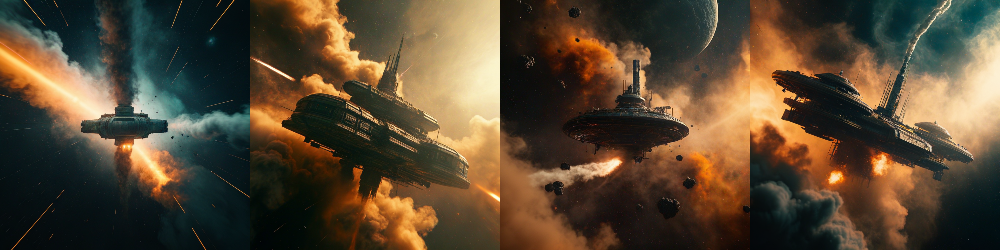

In [63]:
batch_size = 4
# caption = "Cinematic photo of eldercraftian style depiction of an elder god demonic looking creature in the middle of a large ancient roman city"
caption = "Cinematic photo of AbstractChaos style space station with a lot of smoke coming out of"
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

# Stage C Parameters
extras.sampling_configs['cfg'] = 4
extras.sampling_configs['shift'] = 2
extras.sampling_configs['timesteps'] = 20
extras.sampling_configs['t_start'] = 1.0

# Stage B Parameters
extras_b.sampling_configs['cfg'] = 1.1
extras_b.sampling_configs['shift'] = 1
extras_b.sampling_configs['timesteps'] = 10
extras_b.sampling_configs['t_start'] = 1.0

# PREPARE CONDITIONS
batch = {'captions': [caption] * batch_size}
conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=False)
unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(sampled)

save the images

In [64]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_img_{i}_{timestamp}.png'))


# Image Variation

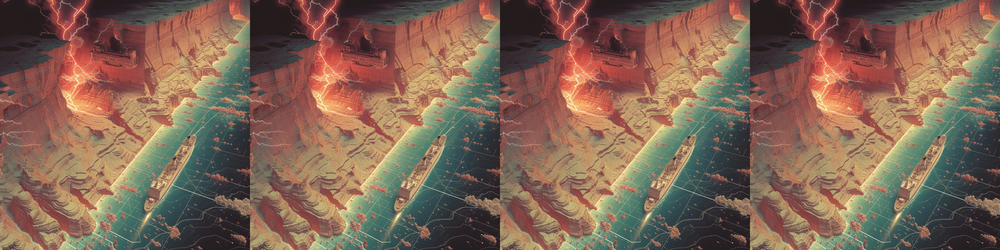

In [66]:
batch_size = 4
# url = "/content/cascade_output/cascade_img_0_20240213_230809699696.png"
url = "https://cdn.discordapp.com/attachments/989484060504109066/1205755915220025364/driftjohnson_CubicFuturism_style_super_futurism_cargo_ship_is_i_d9f035e2-9b1c-4ec7-9752-cd4a18a16f1a.png?ex=65d986b4&is=65c711b4&hm=c6a88c49e05d1954315da4556b9d86826100c6772422eec0fe99499389f51a2a&=&format=webp&quality=lossless"
images = resize_image(download_image(url)).unsqueeze(0).expand(batch_size, -1, -1, -1).to(device)

batch = {'images': images}

show_images(batch['images'])

100%|██████████| 10/10 [00:06<00:00,  1.51it/s]


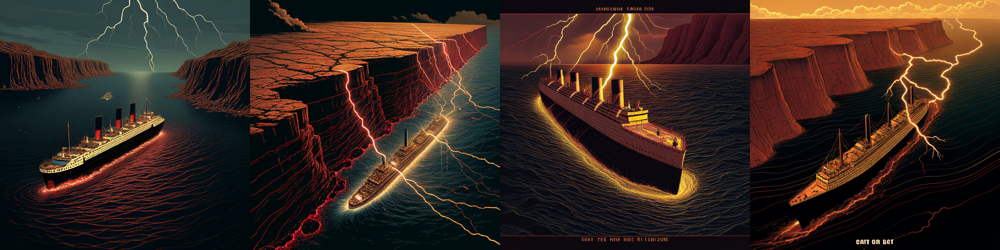

In [67]:
caption = ""
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

# Stage C Parameters
extras.sampling_configs['cfg'] = 4
extras.sampling_configs['shift'] = 2
extras.sampling_configs['timesteps'] = 20
extras.sampling_configs['t_start'] = 1.0

# Stage B Parameters
extras_b.sampling_configs['cfg'] = 1.1
extras_b.sampling_configs['shift'] = 1
extras_b.sampling_configs['timesteps'] = 10
extras_b.sampling_configs['t_start'] = 1.0

# PREPARE CONDITIONS
batch['captions'] = [caption] * batch_size

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)
    conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=True)
    unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
    conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
    unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(sampled)

In [68]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_img_{i}_{timestamp}.png'))


# Image-to-Image

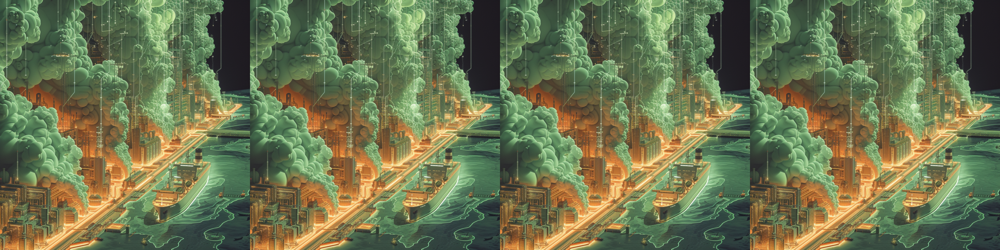

In [69]:
batch_size = 4
url = "https://cdn.discordapp.com/attachments/989484060504109066/1205755905799487488/driftjohnson_CubicFuturism_style_super_futurism_cargo_ship_is_i_e1471599-0932-4f01-84fd-861989e2c023.png?ex=65d986b1&is=65c711b1&hm=0711141a8182a2a9c8345c4eef0d738abdc0992bdc15e7437b18432cd01fa35f&=&format=webp&quality=lossless"
images = resize_image(download_image(url)).unsqueeze(0).expand(batch_size, -1, -1, -1).to(device)

batch = {'images': images}

show_images(batch['images'])

100%|██████████| 10/10 [00:06<00:00,  1.51it/s]


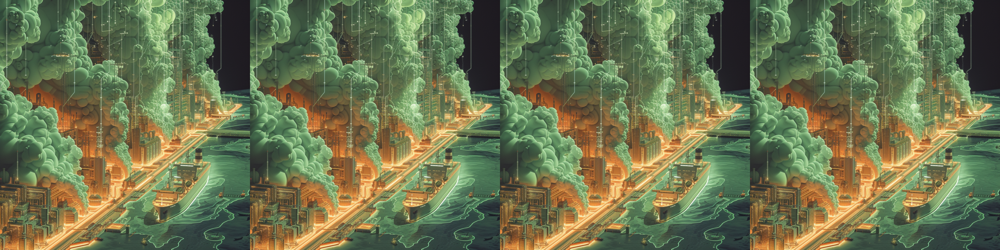

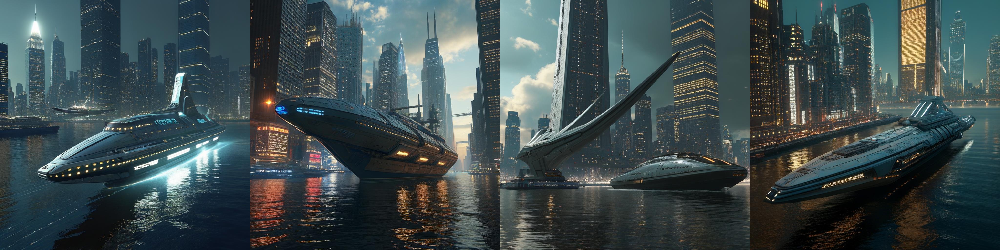

In [71]:
caption = "a futuristic megatanker is sailing past a sci-fi rendition of Manhattan harbor"
noise_level = 0.80
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

effnet_latents = core.encode_latents(batch, models, extras)
t = torch.ones(effnet_latents.size(0), device=device) * noise_level
noised = extras.gdf.diffuse(effnet_latents, t=t)[0]

# Stage C Parameters
extras.sampling_configs['cfg'] = 4
extras.sampling_configs['shift'] = 2
extras.sampling_configs['timesteps'] = int(20 * noise_level)
extras.sampling_configs['t_start'] = noise_level
extras.sampling_configs['x_init'] = noised

# Stage B Parameters
extras_b.sampling_configs['cfg'] = 1.1
extras_b.sampling_configs['shift'] = 1
extras_b.sampling_configs['timesteps'] = 10
extras_b.sampling_configs['t_start'] = 1.0

# PREPARE CONDITIONS
batch['captions'] = [caption] * batch_size

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)
    conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=False)
    unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
    conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
    unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(batch['images'])
show_images(sampled)

In [72]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_img_{i}_{timestamp}.png'))

In [73]:
import os
import shutil

# Source and destination paths
source_dir = '/content/cascade_output'
dest_dir = '/content/drive/MyDrive/cascade_output'

# Create the destination directory if it doesn't exist
if not os.path.exists(dest_dir):
    os.makedirs(dest_dir)

# Copy each file from the source directory to the destination directory
for filename in os.listdir(source_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):  # Check if the file is an image
        shutil.copy(os.path.join(source_dir, filename), os.path.join(dest_dir, filename))

print('Images copied successfully.')

Images copied successfully.
